In [10]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import svm
from sklearn.datasets import make_blobs
from mpl_toolkits.mplot3d import Axes3D
from sklearn.datasets import make_circles


# Support Vector Machines (SVM)
## 1. Introduction and definition of the problem

A Support Vector Machine is a supervised Machine Learning algorithm, mainly used for classification problems, although it also supports regression applications.

Let's imagine we have two types of points, red and blue. An SVM attempts to draw the best possible line separating both groups. We call this line a hyperplane, which is not only based on separating the data, but separating it with the largest possible margin.

The hyperplane maximizes the margin between the two data points closest to each class, which we call support vectors. In this way, we create a line that, instead of passing over the points, passes right through the middle of the margin between the support vectors. This gives us the advantage that when importing new data, we are less likely to make mistakes when classifying it.

Let's look at a diagram of the essential elements that make up an SVM.



![dibujo SVM.png](<attachment:dibujo SVM.png>)
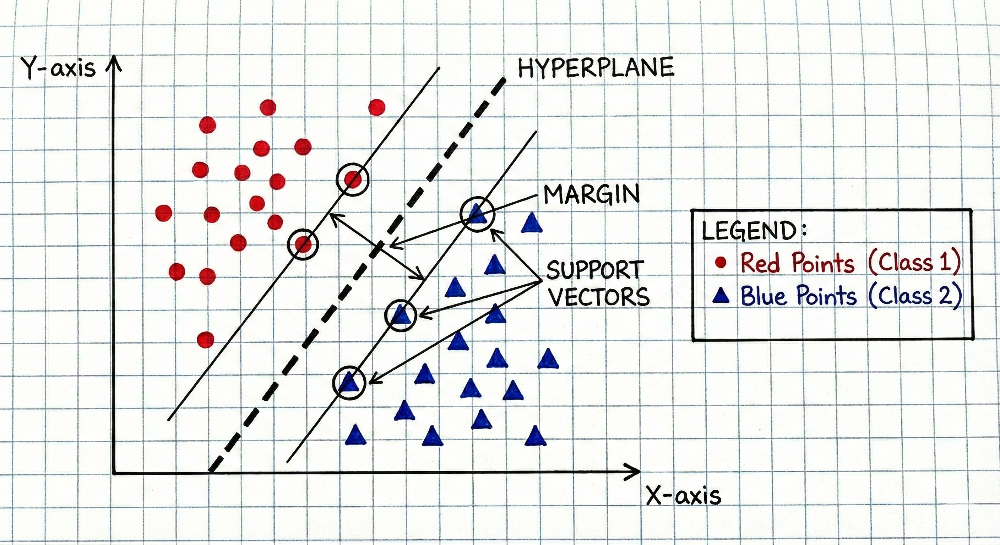

## 2. Linear SVM
Let's look at how SVM works with linearly separable data, i.e., data that can be separated by a straight line or plane. An example of this is the drawing we showed earlier.

### 2.1. Linear SVM in 2D
Let's consider a binary classification with two classes, for example class 0 and class 1. We are going to generate the data to visualize its distribution before using SVM. 

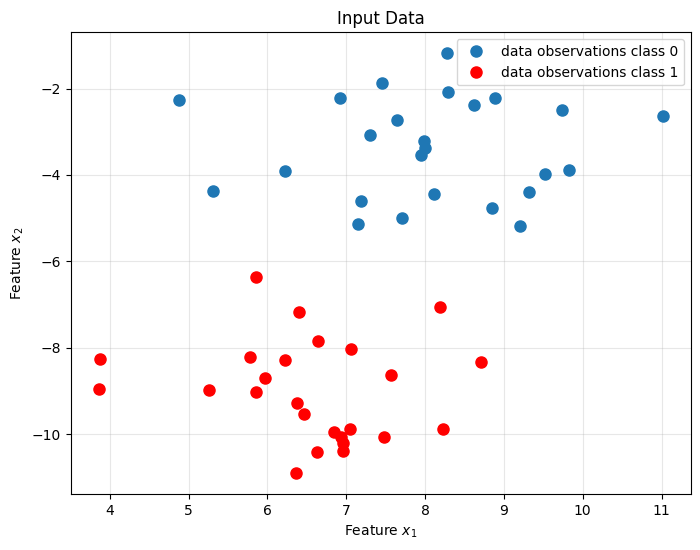

In [11]:
# Reset default matplotlib's configuration (ignore previous custom styles)
plt.rcdefaults()

# Visualize data with blue points and red points
color_c0 = 'C0'     
color_c1 = 'red'    
marker_c0 = 'o'     
marker_c1 = 'o'     

# Data generation
# X_data: INPUT FEAUTRES. 50 samples, 2 classes
# t_data: CLASS LABELS (0 or 1)
X_data, t_data = make_blobs(n_samples=50, centers=2, random_state=6, cluster_std=1.2)
# t_data is reshaped as a column vector (N,1)
t_data = t_data.reshape(-1, 1) 

# Display data
# Initialize figure and axis
fig, ax = plt.subplots(figsize=(8, 6))

# Boolean indexing to separate classes (0 or 1)
idx_class0 = (t_data == 0).flatten()
idx_class1 = (t_data == 1).flatten()

# Plot each class separately 
# Class 0 (blue points)
ax.plot(X_data[idx_class0, 0], X_data[idx_class0, 1], marker=marker_c0, linestyle='', 
        color=color_c0, markersize=8, label='data observations class 0')
# Class 1 (red points)
ax.plot(X_data[idx_class1, 0], X_data[idx_class1, 1], marker=marker_c1, linestyle='', 
        color=color_c1, markersize=8, label='data observations class 1')

# Title and labels
ax.set_title("Input Data")
ax.set_xlabel("Feature $x_1$")
ax.set_ylabel("Feature $x_2$")
ax.legend()
ax.grid(True, alpha=0.3) 

# Display plot
plt.show()

Before applying SVM to this data, let's define what SVM mathematically seeks to solve.

As we indicated in our previous input data example, the labels for our classes are 0 and 1. However, SVM is mathematically formulated with the labels -1 and +1. Let's make this transformation so we can continue with the explanation:
$$
y_i =
\begin{cases}
-1, & \text{if the original label is } 0 \\
\;\,1, & \text{if the original label is } 1
\end{cases}
$$

We will use this transformation solely for mathematical explanation purposes; afterwards, we will re-express the predictions as 0 and 1.

As previously mentioned, the objective of SVM is to find the hyperplane that separates both classes. In 2D, the hyperplane that separates the classes will be a straight line defined as:
$$
\mathbf{w}^T \mathbf{x} + b = 0
$$
where:
- $\mathbf{w}$ is the **normal vector to the hyperplane** in the direction perpendicular to it,
- $\mathbf{x}$ s a **feature vector**,
- $b$ is the **bias term** that shifts the hyperplane relative to the origin.

This line will divide the feature space into two regions, leaving everything of one class on one side and everything of the other class on the other.

To classify the data, the predicted class for a point x will be obtained by evaluating the sign of:
$$
f(\mathbf{x}) = \mathbf{w}^T \mathbf{x} + b
$$
using the decision rule:
$$
y = 
\begin{cases}
+1, & \text{si } \mathbf{w}^T \mathbf{x} + b \ge 0 \\
-1, & \text{si } \mathbf{w}^T \mathbf{x} + b < 0
\end{cases}
$$

Those with a positive sign (including 0) will belong to class +1, while those with a negative sign will belong to -1. Once these labels have been obtained, we will transform them back to our original classes:
$$
y_{\text{original}} =
\begin{cases}
+1 \rightarrow 1, \\
-1 \rightarrow 0
\end{cases}
$$

As we mentioned earlier, SVM not only seeks to separate classes, but to do so in the best possible way. To achieve this, the hyperplane that separates the classes seeks to maximize the margin, i.e., the distance between the hyperplane and the support vectors.

Mathematically, the distance from a point xi to the hyperplane is:
$$
d_i = \frac{|\mathbf{w}^T \mathbf{x}_i + b|}{\|\mathbf{w}\|}
$$
where:
- **Numerator** indicates how far point xi is from the hyperplane.
- **Denominator** Euclidean norm of vector $\mathbf{w}$, normalizes the distance so that it depends only on the position relative to the hyperplane.

Using this distance, we will be able to identify which vectors are support vectors, which will have the minimum distance di and will therefore be closest to the hyperplane.

Now that we have mathematically defined all the elements of an SVM, we will explain how to find the best hyperplane. Our goal is for the hyperplane to maximize the margin between both classes, while ensuring that all points are correctly classified.
Since the margin is the distance between the support vectors and the hyperplane, we can also express it with the distance formula:
$$
\text{margin} = d_i = \frac{|\mathbf{w}^T \mathbf{x}_i + b|}{\|\mathbf{w}\|}
$$

We want the support vectors to satisfy the condition that 
$$
|\mathbf{w}^T \mathbf{x}_i + b| = 1
$$

In this way, we simplify the problem and clearly define that the support vectors are exactly on the margin boundary. We change the scale of w and b by multiplying them by positive numbers, which does not change the line, but in this way we obtain:
$$
\text{margin}
= \frac{|\mathbf{w}^T \mathbf{x}_i + b|}{\|\mathbf{w}\|}
= \frac{1}{\|\mathbf{w}\|}
$$

To maximize the margin, we need the norm of vector $\mathbf{w}$ to be as small as possible. This way, our problem becomes minimizing the norm of vector $\mathbf{w}$. To derive it more easily and penalize larger errors more, we will square the norm and multiply it by 1/2, which is equivalent to what we had before. We are left with this optimization problem:
$$
\min_{\mathbf{w}, b} \frac{1}{2} \|\mathbf{w}\|^2
$$

However, we cannot use just any w, because otherwise the classes would not be separated. Therefore, we need to add constraints to our optimization problem, ensuring that all points are correctly classified and respect the margin. 
To ensure that no point is within the margin, we set two parallel lines that pass right through the support vector of each class:
$$
\begin{cases}
\mathbf{w}^T \mathbf{x} + b = +1 \\
\mathbf{w}^T \mathbf{x} + b = -1
\end{cases}
$$

For a point of class +1, it must be to the right of the hyperplane and outside the margin. Meanwhile, a point of class -1 must be to the left of the hyperplane and outside the margin. That is:
$$
\begin{cases}
y_i = +1,\; y_i(\mathbf{w}^T \mathbf{x}_i + b) \ge 1 \\
y_i = -1,\; y_i(\mathbf{w}^T \mathbf{x}_i + b) \ge 1
\end{cases}
$$

If we combine both cases into a single constraint, we are left with the SVM constraint:
$$
y_i(\mathbf{w}^T \mathbf{x}_i + b) \ge 1 \quad \forall i,\; i = 1,2,\ldots,m
$$
This ensures that a point xi is correctly classified, outside the margin, and also that the margin size is normalized (fixed).

To solve an optimization problem subject to constraints, we must use Lagrange multipliers. The first thing we must do is construct the Lagrange function, which is defined as: 
$$
\mathcal{L}(x, \boldsymbol{\alpha}) = f(x) - \sum_{i=1}^{n} \alpha_i\, g_i(x)
$$

Where α is a vector of n Lagrange multipliers. With our function to be optimized and the constraint we defined earlier, we are left with:
$$
\mathcal{L}(\mathbf{w}, b, \boldsymbol{\alpha}) 
= \frac{1}{2} \|\mathbf{w}\|^2 
- \sum_{i=1}^{m} \alpha_i \left[ y_i (\mathbf{w}^T \mathbf{x}_i + b) - 1 \right]
$$

Where αi will be 0 if the point xi satisfies the constraint, or αi > 0 for the support vectors, since they are the ones that actually define the hyperplane.

Once we have constructed the Lagrange function, as we are dealing with an optimization problem, we must differentiate it with respect to w and b.	
We take the partial derivative of the Lagrange function with respect to w and set it equal to 0. This allows us to solve for w:
$$
\frac{\partial \mathcal{L}}{\partial \mathbf{w}} = 0 
\quad \Rightarrow \quad
\mathbf{w} - \sum_{i=1}^{m} \alpha_i y_i \mathbf{x}_i = 0
\quad \Rightarrow \quad
\mathbf{w} = \sum_{i=1}^{m} \alpha_i y_i \mathbf{x}_i
$$
This tells us that the vector $\mathbf{w}$ is constructed as a linear combination of the support vectors, since the other points will be αi = 0. Now we take the partial derivative of the Lagrange function with respect to b, and set it equal to 0, which gives us:
$$
\frac{\partial \mathcal{L}}{\partial b} = 0 
\quad \Rightarrow \quad
\sum_{i=1}^{m} \alpha_i y_i = 0
$$
Ensuring that the position of the hyperplane meets all constraints. 

To solve this, since we have $\mathbf{w}$ cleared as a function of αi, we simply substitute it into the Lagrange function. In this way, we reduce the optimization problem to only αi. Substituting $\mathbf{w}$ gives us:
$$
\mathcal{L}(\boldsymbol{\alpha}, b) 
= \frac{1}{2} \sum_{i=1}^{m} \sum_{j=1}^{m} \alpha_i \alpha_j y_i y_j \mathbf{x}_i^T \mathbf{x}_j
- \sum_{i=1}^{m} \alpha_i \Big[ y_i \Big( \sum_{j=1}^{m} \alpha_j y_j \mathbf{x}_j^T \mathbf{x}_i + b \Big) - 1 \Big]
$$
As we have obtained in the partial derivative with respect to b, we have that 
$$
\sum_{i=1}^{m} \alpha_i y_i = 0
$$
Therefore, this term will disappear, and we are left with a Lagrange function solely in terms of αi:
$$
\mathcal{L}(\boldsymbol{\alpha}) = \sum_{i=1}^{m} \alpha_i 
- \frac{1}{2} \sum_{i=1}^{m} \sum_{j=1}^{m} \alpha_i \alpha_j y_i y_j \mathbf{x}_i^T \mathbf{x}_j
$$

Now the restriction on b has disappeared, and we are left with only the conditions:
$$
\alpha_i \ge 0,\quad \sum_{i=1}^{m} \alpha_i y_i = 0
$$

under the constraints:
$$
\alpha_i \ge 0, \quad \sum_{i=1}^{m} \alpha_i y_i = 0
$$

By solving the dual problem, we obtain the optimal values αi* through convex optimization algorithms QP solvers, or the SMO algorithm. In Machine Learning, solving QP by hand can be very difficult if we have a lot of data, so we will use SMO (Sequential Minimal Optimization) to do it efficiently. SMO chooses two αi at a time and calculates the values that maximize the dual function for these two αi. Once the new αi are calculated, they replace the old ones, and the process is repeated until none of the αi values can further improve the dual function and the constraints are met. In this way, all αi converge to their optimal values αi*.

Of these optimal values obtained, the points αi* > 0 are the support vectors that will define our hyperplane (the others, αi*=0, have no effect).  Now, we will reconstruct the hyperplane with the support vectors and their αi*. The vector $\mathbf{w}$, perpendicular to the hyperplane, is: 
$$
\mathbf{w} = \sum_{i=1}^{m} \alpha_i ^* y_i \mathbf{x}_i
$$
where only the support vectors will contribute to this sum, the rest being αi* > 0. This vector defines the orientation of the hyperplane. Meanwhile, the bias term b, which shifts the hyperplane relative to the origin, will depend on the support vectors to know exactly where the margin is. Clearing b, we are left with: 
$$
y_s (\mathbf{w}^T \mathbf{x}_s + b) = 1
\quad \Rightarrow \quad
b = y_s - \mathbf{w}^T \mathbf{x}_s
$$
where $\mathbf{x_s}$ is any support vector. If there are several support vectors, we can average the values of b in this way and achieve greater stability.

Since we have w and b, we will use the decision rule we defined earlier to see which class a new point belongs to, and then we will transform it into our original classes 0 and 1. We are left with: 
$$
\hat{y} = 
\begin{cases}
+1, & \text{if } \mathbf{w}^T \mathbf{x} + b \ge 0 \\[2mm]
-1, & \text{if } \mathbf{w}^T \mathbf{x} + b < 0
\end{cases}
\quad , \quad
y_{\text{original}} =
\begin{cases}
+1 \rightarrow 1, \\[1mm]
-1 \rightarrow 0
\end{cases}
$$

In addition, we can now graph the hyperplane and the margins. Let's look at a graph to see how this is done.

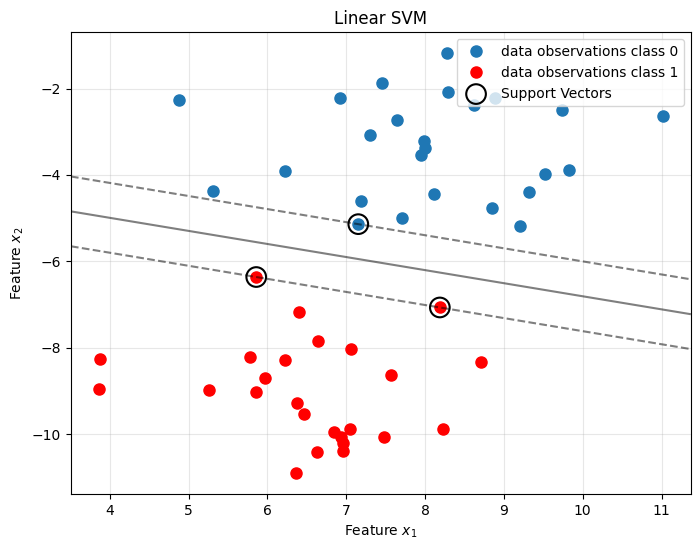

In [12]:
# SVM Model Training
# Linear SVM classifier, using linear kernel, C=1000 to enforce a hard margin, minimizing misclassification
clf = svm.SVC(kernel='linear', C=1000)

# Fit SVM to the dataset
clf.fit(X_data, t_data.ravel())

# Results visualization
# Crate figure and axis
fig, ax = plt.subplots(figsize=(8, 6))

# Plot original data points for each class (as earlier)
ax.plot(X_data[idx_class0, 0], X_data[idx_class0, 1], marker=marker_c0, linestyle='', 
        color=color_c0, markersize=8, label='data observations class 0')
ax.plot(X_data[idx_class1, 0], X_data[idx_class1, 1], marker=marker_c1, linestyle='', 
        color=color_c1, markersize=8, label='data observations class 1')

# Get axis limits to create a grid of points
xlim = ax.get_xlim()
ylim = ax.get_ylim()

# Create a 2d grid from x and y points
xx = np.linspace(xlim[0], xlim[1], 30)
yy = np.linspace(ylim[0], ylim[1], 30)
YY, XX = np.meshgrid(yy, xx)
xy = np.vstack([XX.ravel(), YY.ravel()]).T

# Evaluate SVM decision function on grid, "how far a point xi is from the hyperplane"
Z = clf.decision_function(xy).reshape(XX.shape)

# Contours to draw the hyperplane
#  Solid hyperplane (0), dashed margins (-1 and 1)
# Semi transparent lines
ax.contour(XX, YY, Z, colors='k', levels=[-1, 0, 1], alpha=0.5, linestyles=['--', '-', '--'])

# Scatter support vectors, using circles with black edges
ax.scatter(clf.support_vectors_[:, 0], clf.support_vectors_[:, 1], s=200,
           linewidth=1.5, facecolors='none', edgecolors='k', label='Support Vectors')

# Title and labels
ax.set_title("Linear SVM")
ax.set_xlabel("Feature $x_1$")
ax.set_ylabel("Feature $x_2$")
ax.legend(loc='upper right')
ax.grid(True, alpha=0.3)

# Display plot
plt.show()

### 2.2. Linear SVM in 3D
In 3D, we maintain the logic of searching for the hyperplane that maximizes the distance to the support vectors. However, now it becomes a plane instead of a line. Similarly, the plane is defined as:
$$
\mathbf{w}^T \mathbf{x} + b = 0
$$
where $\mathbf{w}$ = (w1, w2, w3) is the normal vector to the plane, and b is the bias that shifts the plane relative to the origin.

The prediction for a new point xi is made in the same way as in 2D, leaving the +1 region on one side of the plane and the -1 region on the other side of the plane. Let's see visually how the hyperplane becomes a plane in 3D.


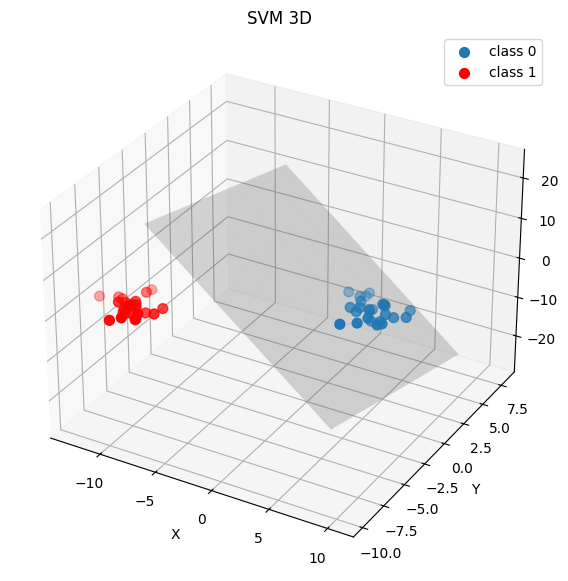

In [13]:
# Define data in 3D with n_features=3
X_3d, t_3d = make_blobs(n_samples=50, centers=2, random_state=6, n_features=3)

# Boolean indexs to separate both classes
idx_c0_3d = t_3d == 0
idx_c1_3d = t_3d == 1

# SVM Model Training
# Linear SVM classifier, using linear kernel
clf_3d = svm.SVC(kernel='linear')

# Fit SVM to the 3D data
clf_3d.fit(X_3d, t_3d)

# Results visualization
# Crate figure and axis
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Scatter data points
ax.scatter(X_3d[idx_c0_3d, 0], X_3d[idx_c0_3d, 1], X_3d[idx_c0_3d, 2], 
           c=color_c0, marker=marker_c0, s=50, label='class 0')
ax.scatter(X_3d[idx_c1_3d, 0], X_3d[idx_c1_3d, 1], X_3d[idx_c1_3d, 2], 
           c=color_c1, marker=marker_c1, s=50, label='class 1')

# Plot hyperplane
# Extract coefficients, vector w and bias term b
w = clf_3d.coef_[0]
b = clf_3d.intercept_[0]

# Create a grid from x and y points
xx_surf, yy_surf = np.meshgrid(np.linspace(-8, 8, 10), np.linspace(-8, 8, 10))

# Solve plane equation
zz_surf = (-b - w[0]*xx_surf - w[1]*yy_surf) / w[2]

# Draw plane
# alpha = 0.2 opacity to see the points
ax.plot_surface(xx_surf, yy_surf, zz_surf, alpha=0.2, color='gray')

# Title and labels
ax.set_title("SVM 3D")
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
ax.legend()

# Display plot
plt.show()

## 3. Nonlinear SVM
So far, we have seen data that can be easily separated by a straight line or plane. However, in the real world, there are complex data structures where this is not possible. Let's look at an example drawing of concentric rings.


![anillo datos.png](<attachment:anillo datos.png>)
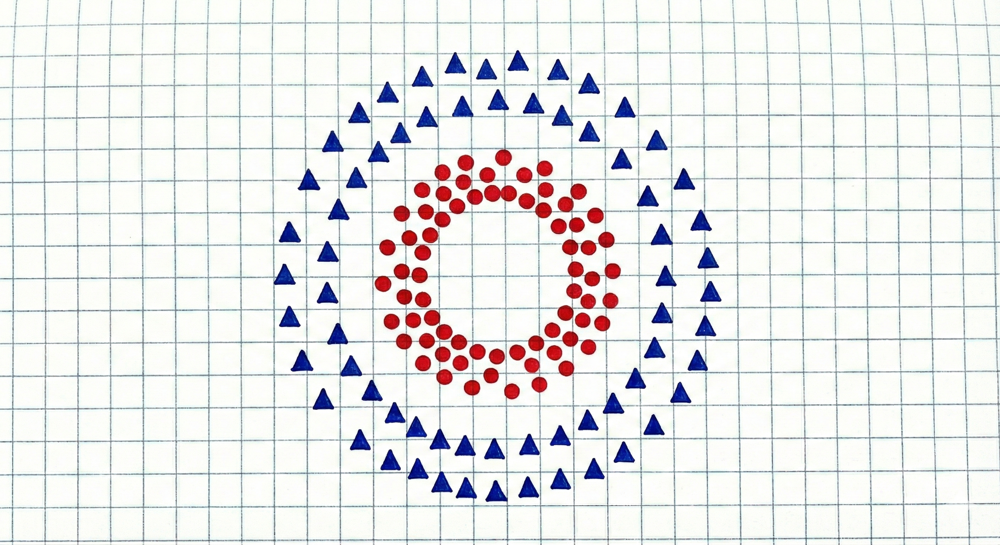

To make this data linearly separable, we will process the training data in a higher-dimensional feature space. This increases complexity, raising the risk of overfitting and greater computational load. We will reduce this complexity with the help of kernel functions. Some of the most popular kernel functions are:
- Polynomial kernel.
- Radial basis function (or RBF) kernel.
- Sigmoid kernel.

Mathematically, by using a kernel function K(xi,xj) to map the data to a higher-dimensional space and make it linearly separable, we will replace it in the dual SVM problem:
$$
\mathbf{x}_i^T \mathbf{x}_j \;\; \longrightarrow \;\; K(\mathbf{x}_i, \mathbf{x}_j)
$$
Therefore, the dual problem of SVM is:
$$
\mathcal{L}(\boldsymbol{\alpha}) = \sum_{i=1}^{m} \alpha_i 
- \frac{1}{2} \sum_{i=1}^{m} \sum_{j=1}^{m} \alpha_i \alpha_j y_i y_j K(\mathbf{x}_i, \mathbf{x}_j)
$$
which will be the basis for the nonlinear SVMs mentioned above, polynomial, RBF, or sigmoid.

### 3.2. Nonlinear SVM in 2D
Let's visualize how SVM works on nonlinear data in 2D. First, let's visualize the data that cannot be separated linearly.

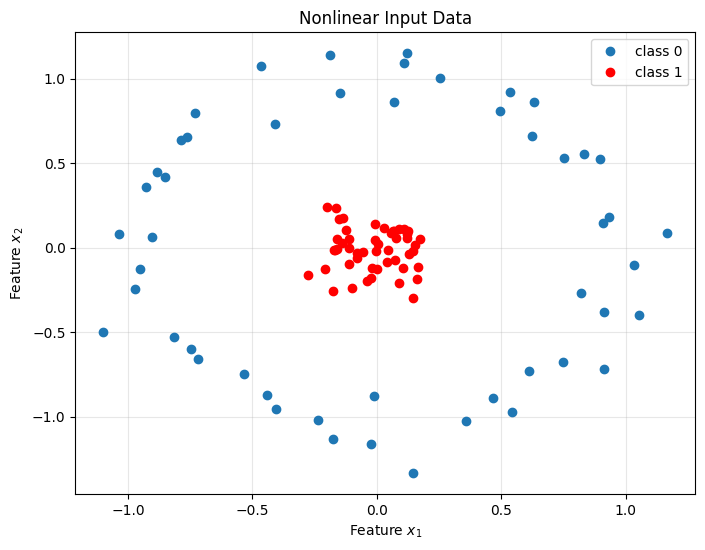

In [14]:
# Generate two concentric circles to plot circular data
X_circ, t_circ = make_circles(n_samples=100, factor=0.1, noise=0.1, random_state=0)

# Boolean indexs to separate both classes
idx_c0_circ = t_circ == 0
idx_c1_circ = t_circ == 1

# Results visualization
# Crate figure and axis
fig, ax = plt.subplots(figsize=(8, 6))

# Plot data points for each class (as earlier)
ax.plot(X_circ[idx_c0_circ, 0], X_circ[idx_c0_circ, 1], marker=marker_c0, linestyle='', 
        color=color_c0, label='class 0')
ax.plot(X_circ[idx_c1_circ, 0], X_circ[idx_c1_circ, 1], marker=marker_c1, linestyle='', 
        color=color_c1, label='class 1')

# Title and labels
ax.set_title("Nonlinear Input Data")
ax.set_xlabel("Feature $x_1$")
ax.set_ylabel("Feature $x_2$")
ax.legend()
ax.grid(True, alpha=0.3)

# Dipsplay plot
plt.show()

Let's visualize that if we tried to apply SVM to this circular data, the model would attempt to draw a straight line, which would result in a high error rate, as it is mathematically impossible to do so with precision.

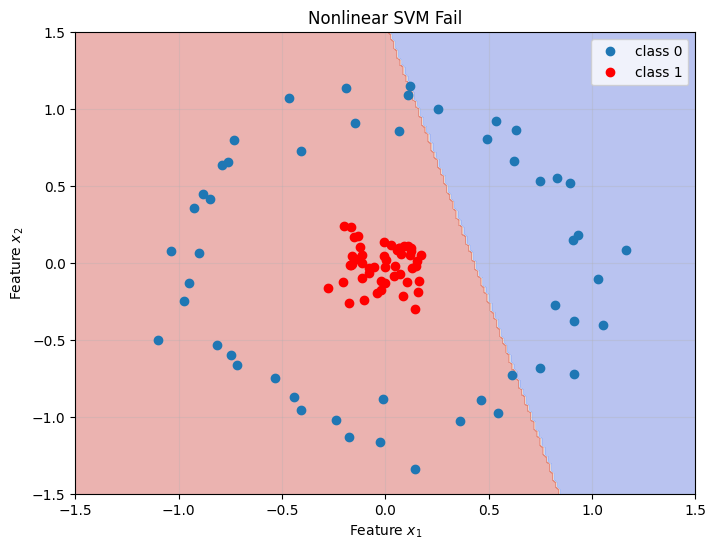

Linear SVM model accuracy: 0.68


In [15]:
# SVM Model Training
# Linear SVM classifier, using linear kernel
clf_lin_fail = svm.SVC(kernel='linear')

# Fit SVM to the circular dataset
clf_lin_fail.fit(X_circ, t_circ)

# Fail results visualization
# Crate figure and axis
fig, ax = plt.subplots(figsize=(8, 6))

# Create grid
xx, yy = np.meshgrid(np.linspace(-1.5, 1.5, 200), np.linspace(-1.5, 1.5, 200))

# Predcitions
Z = clf_lin_fail.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

# Draw decision regions
ax.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.4)

# Plot data points for each class (as earlier)
ax.plot(X_circ[idx_c0_circ, 0], X_circ[idx_c0_circ, 1], marker=marker_c0, linestyle='', 
        color=color_c0, label='class 0')
ax.plot(X_circ[idx_c1_circ, 0], X_circ[idx_c1_circ, 1], marker=marker_c1, linestyle='', 
        color=color_c1, label='class 1')

# Title and labels
ax.set_title("Nonlinear SVM Fail")
ax.set_xlabel("Feature $x_1$")
ax.set_ylabel("Feature $x_2$")
ax.legend()
ax.grid(True, alpha=0.3)

# Dipsplay plot
plt.show()

# Show accuracy to demonstrate failure
print(f"Linear SVM model accuracy: {clf_lin_fail.score(X_circ, t_circ):.2f}")

We obtain an accuracy lower than 1, which demonstrates the error when attempting to draw a hyperplane that separates this type of data. To resolve this, as we mentioned previously, we are going to expand to approximately 3 dimensions. In this way, we obtain a new perspective for separating the data.

### 3.2. Nonlinear SVM in 3D
Using the existing characteristics, we are going to create a new dimension. If we imagine that z is the distance to the center:
$$
z = x_1^2 + x_2^2
$$
the points in the center (red) will have a small z, so they will remain below, while the outer points (blue) will have a large z and will rise. By raising this data, we can pass a horizontal plane between them that is capable of separating them. Let's look at a drawing of this idea.


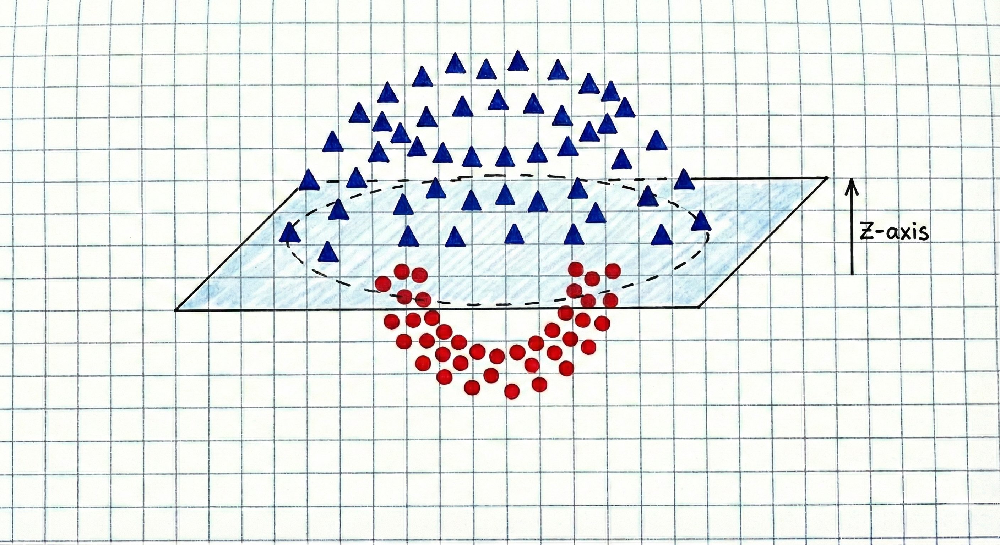

With this idea in mind, let's visualize how our data looks.

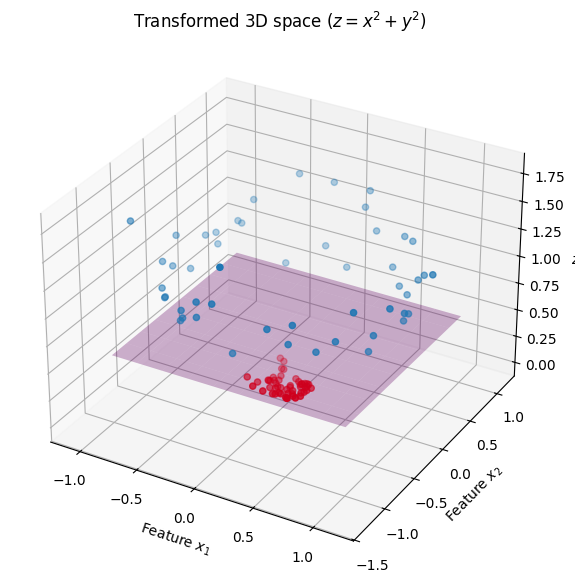

In [16]:
# Transformation
# 2D points into 3D points
z_vals = X_circ[:, 0]**2 + X_circ[:, 1]**2

# Results visualization
# Crate figure and axis
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Plot data points for each class (as earlier)
ax.scatter(X_circ[idx_c0_circ, 0], X_circ[idx_c0_circ, 1], z_vals[idx_c0_circ], 
           c=color_c0, marker=marker_c0, label='class 0')
ax.scatter(X_circ[idx_c1_circ, 0], X_circ[idx_c1_circ, 1], z_vals[idx_c1_circ], 
           c=color_c1, marker=marker_c1, label='class 1')

# Flat reference plane
# Semitransparent to visualize points
xx_p, yy_p = np.meshgrid(np.linspace(-1,1,10), np.linspace(-1,1,10))
zz_p = np.ones_like(xx_p) * 0.5 
ax.plot_surface(xx_p, yy_p, zz_p, alpha=0.3, color='purple')

# Title and labels
ax.set_title("Transformed 3D space ($z = x^2 + y^2$)")
ax.set_xlabel("Feature $x_1$")
ax.set_ylabel("Feature $x_2$")
ax.set_zlabel("$z$")

# Display plot
plt.show()

Calculating these transformations in higher dimensions can be costly or even impossible if we have to reach a very high dimension. Therefore, SVM uses the kernel functions mentioned above to make it more efficient. 

### 3.3. SVM with Kernel Functions
The Kernel trick allows us to directly calculate complex boundaries without explicitly transforming the data. It does this by directly calculating the inner product of the vectors in that dimension, finding a linear hyperplane in that dimension. In this way, we obtain a nonlinear boundary with which we can visualize how SVM separates the classes.

Let's visualize how this is achieved with polynomial kernel and RBF kernel functions.

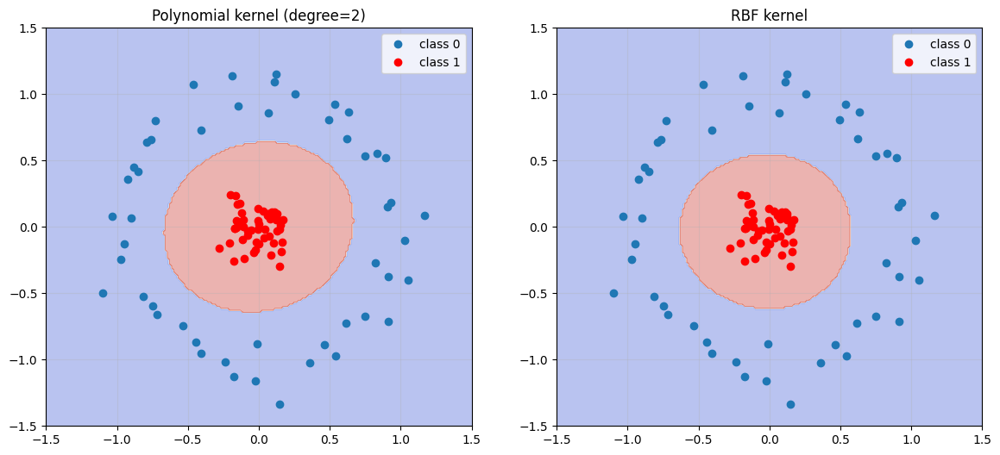

In [17]:
# SVM models
# Polynomial kernel (quadratic) and RBF kernel
modelos = (svm.SVC(kernel='poly', degree=2),
           svm.SVC(kernel='rbf', gamma=1.0))

# Titles for each one
titulos = ('Polynomial kernel (degree=2)',
           'RBF kernel')

# Results visualization
# Crate two plots in one row
fig, sub = plt.subplots(1, 2, figsize=(14, 6))

# Create a grid
xx, yy = np.meshgrid(np.linspace(-1.5, 1.5, 200), np.linspace(-1.5, 1.5, 200))

# Train each model
for clf, title, ax in zip(modelos, titulos, sub.flatten()):
    clf.fit(X_circ, t_circ)

    # Add predictions
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    
    # Plot decision regions
    # Semitransparent to view points
    ax.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.4)
    
    # Plot original data points for each class (as earlier)
    ax.plot(X_circ[idx_c0_circ, 0], X_circ[idx_c0_circ, 1], marker=marker_c0, linestyle='', 
            color=color_c0, label='class 0')
    ax.plot(X_circ[idx_c1_circ, 0], X_circ[idx_c1_circ, 1], marker=marker_c1, linestyle='', 
            color=color_c1, label='class 1')
    
    # Title and labels
    ax.set_title(title)
    ax.legend()
    ax.grid(True, alpha=0.3)

# Display plot
plt.show()

We can see how SVM now manages to obtain the correct classification thanks to the Kenrel functions.

## 4. Conclusions
### 4.1. Advantages and disadvantages
After seeing how SVMs work in classification problems, both linear and nonlinear, in 2D and higher-dimensional spaces, we can draw some conclusions from our observations.

Based on the results and SVM theory, we can highlight some strengths of its operation. Among them are its memory efficiency, since hyperplanes depend solely on support vectors. We also highlight its ability to handle higher-dimensional spaces and its robustness against outliers.

However, the model is sensitive to feature scaling, which requires prior normalization of the data. In addition, the adjustment of parameters and optimal values, for example, the Kernel function to be used, is critical in the process, and a poor choice can lead to very poor performance. Performance can also be affected in very large datasets, as training time becomes very slow.

### 4.2. Comparison with Logistic Regression
In another section of the course, we studied how Logistic Regression works for data classification in supervised learning. Compared to SVM, we can conclude that SVM offers better performance on unstructured and larger datasets, as Logistic Regression is not able to adapt as well to this type of data.

Logistic regression minimizes the overall error of the probability of belonging to a class, while SVM is based on maximizing the geometric margin between classes. Therefore, SVM is less sensitive to overfitting and offers a clearer interpretation of the decision boundary. However, SVM has a higher computational cost than Logistic Regression.
